# New York City AirBnB Project

**By: Evan King, Matteo Romeo, Aidan Walker, Sienna Nguyen, Ethan France**

# Part 1: Data Preparation and Cleansing

In [ ]:
# ONLY RUN IN GOOGLE COLAB
# Import importlib to check for available modules
import importlib

required_modules = [
    'pandas',
    'numpy',
    'matplotlib.pyplot',
    'seaborn',
    'datetime',
    'google.colab',
    'kagglehub'
]

# Check and install missing modules
for module in required_modules:
    try:
        importlib.import_module(module)
        print(f"{module} is already installed.")
    except ImportError:
        print(f"{module} is not installed. Installing now...")
       !pip install {module} if module != 'google.colab' else !echo "google.colab is built in"
        print(f"{module} installation complete.")

# Import the modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from google.colab import output
import kagglehub

pandas is already installed.
numpy is already installed.
matplotlib.pyplot is already installed.
seaborn is already installed.
datetime is already installed.
google.colab is not installed. Installing now...
google.colab installation complete.
kagglehub is already installed.


## Import Data

In [4]:
# Define data types for calendar.csv
calendar_dtypes = {
    'listing_id': 'Int64',
    'date': str,
    'available': str,
    'price': str,
    'adjusted_price': str,
    'minimum_nights': 'Int64',
    'maximum_nights': 'Int64'
}

# URLs for Inside Airbnb datasets
listings_url = 'https://data.insideairbnb.com/united-states/ny/new-york-city/2025-03-01/data/listings.csv.gz'
calendar_url = 'https://data.insideairbnb.com/united-states/ny/new-york-city/2025-03-01/data/calendar.csv.gz'

# Load datasets from URLs
listings = pd.read_csv(listings_url, compression='gzip')
calendar = pd.read_csv(calendar_url, dtype=calendar_dtypes, compression='gzip')

# Load the Kaggle dataset (AB_NYC_2019.csv)
dataset_path = kagglehub.dataset_download("dgomonov/new-york-city-airbnb-open-data")
file_path = f"{dataset_path}/AB_NYC_2019.csv"

# Read the file
try:
    nyc_2019 = pd.read_csv(file_path, encoding='utf-8')
except UnicodeDecodeError:
    nyc_2019 = pd.read_csv(file_path, encoding='latin1')

print("Datasets loaded successfully!")
print("Listings shape:", listings.shape)
print("Calendar shape:", calendar.shape)
print("NYC 2019 shape:", nyc_2019.shape)

KeyboardInterrupt: 

In [ ]:
# Check data types of calendar
print("Calendar Data Types:")
print(calendar.dtypes)

# Check for missing values
print("\nMissing Values in Calendar:")
print(calendar[['minimum_nights', 'maximum_nights']].isnull().sum())

Calendar Data Types:
listing_id         Int64
date              object
available         object
price             object
adjusted_price    object
minimum_nights     Int64
maximum_nights     Int64
dtype: object

Missing Values in Calendar:
minimum_nights    3
maximum_nights    3
dtype: int64


In [ ]:
# Check for missing values in listings
print("Missing Values in Listings:")
print(listings.isnull().sum())

# Remove dollar signs and commas
listings['price'] = listings['price'].replace('[\$,]', '', regex=True).astype(float)

print("\nListings Data Types:")
print(listings.dtypes)

Missing Values in Listings:
id                                                  0
listing_url                                         0
scrape_id                                           0
last_scraped                                        0
source                                              0
                                                ...  
calculated_host_listings_count                      0
calculated_host_listings_count_entire_homes         0
calculated_host_listings_count_private_rooms        0
calculated_host_listings_count_shared_rooms         0
reviews_per_month                               11787
Length: 79, dtype: int64

Listings Data Types:
id                                                int64
listing_url                                      object
scrape_id                                         int64
last_scraped                                     object
source                                           object
                                                 ..

## Clean Data

In [ ]:
# Drop rows with missing price in listings
listings = listings.dropna(subset=['price'])

# Drop rows with missing price in AB_NYC_2019
nyc_2019 = nyc_2019.dropna(subset=['price'])

In [ ]:
# Convert price and adjusted_price to float
calendar['price'] = calendar['price'].replace(r'[\$,]', '', regex=True).astype(float)
calendar['adjusted_price'] = calendar['adjusted_price'].replace(r'[\$,]', '', regex=True).fillna(0).astype(float)

# Convert date to datetime
calendar['date'] = pd.to_datetime(calendar['date'])

# Add a 'booked' column (1 if not available, 0 if available)
calendar['booked'] = calendar['available'].apply(lambda x: 1 if x == 'f' else 0)

# Part 2: Price Analysis

In [ ]:
# Calculate average price by neighborhood for listings.csv (2025 data)
avg_price_by_neighborhood_listings = listings.groupby('neighbourhood_cleansed')['price'].mean().sort_values(ascending=False)
print("Average Price by Neighborhood (Inside Airbnb 2025 Data):")
print(avg_price_by_neighborhood_listings.head(10))  # Top 10 neighborhoods

# Calculate average price by neighborhood for AB_NYC_2019.csv (2019 data)
avg_price_by_neighborhood_2019 = nyc_2019.groupby('neighbourhood')['price'].mean().sort_values(ascending=False)
print("\nAverage Price by Neighborhood (Kaggle 2019 Data):")
print(avg_price_by_neighborhood_2019.head(10))  # Top 10 neighborhoods

Average Price by Neighborhood (Inside Airbnb 2025 Data):
neighbourhood_cleansed
SoHo                 806.086420
Battery Park City    753.666667
Riverdale            715.666667
Navy Yard            621.000000
Fort Wadsworth       600.000000
Tribeca              586.759259
NoHo                 565.833333
Longwood             421.800000
Flatiron District    415.021739
Greenwich Village    408.763158
Name: price, dtype: float64

Average Price by Neighborhood (Kaggle 2019 Data):
neighbourhood
Fort Wadsworth       800.000000
Woodrow              700.000000
Tribeca              490.638418
Sea Gate             487.857143
Riverdale            442.090909
Prince's Bay         409.500000
Battery Park City    367.557143
Flatiron District    341.925000
Randall Manor        336.000000
NoHo                 295.717949
Name: price, dtype: float64


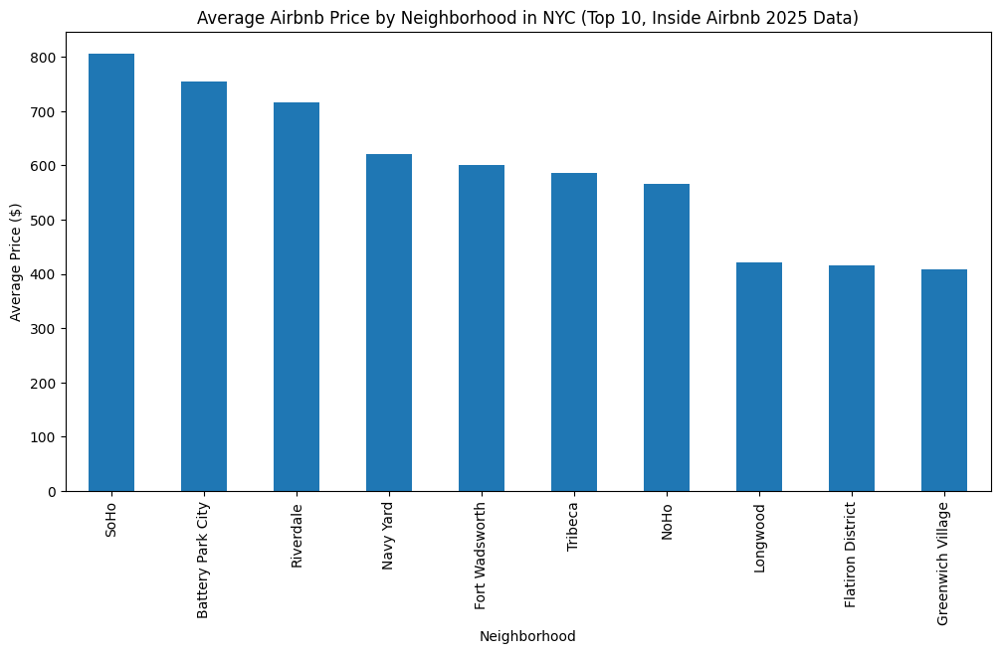

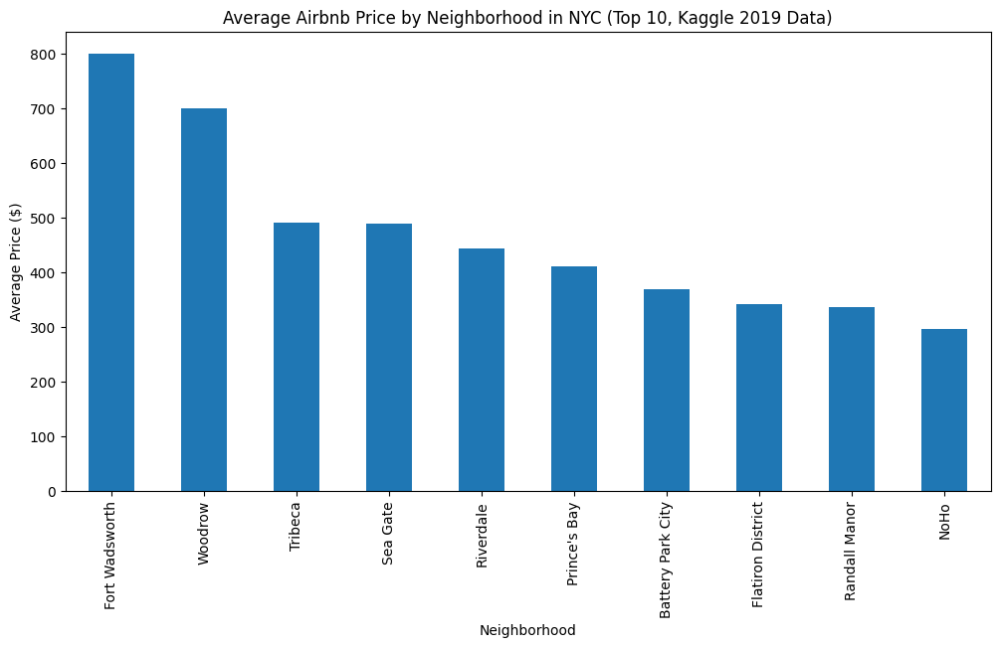

In [ ]:
# Plot average price by neighborhood (top 10, listings.csv)
avg_price_by_neighborhood_listings.head(10).plot(kind='bar', figsize=(12, 6))
plt.title('Average Airbnb Price by Neighborhood in NYC (Top 10, Inside Airbnb 2025 Data)')
plt.xlabel('Neighborhood')
plt.ylabel('Average Price ($)')
plt.show()

# Plot average price by neighborhood (top 10, AB_NYC_2019.csv)
avg_price_by_neighborhood_2019.head(10).plot(kind='bar', figsize=(12, 6))
plt.title('Average Airbnb Price by Neighborhood in NYC (Top 10, Kaggle 2019 Data)')
plt.xlabel('Neighborhood')
plt.ylabel('Average Price ($)')
plt.show()

In [ ]:
# Comparing differences in price by neighborhood

avg_price_neighborhood = listings.groupby('neighbourhood')['price'].mean().sort_values(ascending=False)
print("Average Price by Neighborhood:")
print(avg_price_neighborhood)

Average Price by Neighborhood:
neighbourhood
Neighborhood highlights    224.40964
Name: price, dtype: float64


In [ ]:
# Finding the periods that are most booked

calendar['month'] = calendar['date'].dt.month
calendar['year'] = calendar['date'].dt.year

monthly_occupancy = calendar.groupby(['year', 'month'])['booked'].mean()
print("Monthly Occupancy Rate:")
print(monthly_occupancy)

Monthly Occupancy Rate:
year  month
2025  3        0.628056
      4        0.562305
      5        0.527317
      6        0.549219
      7        0.530710
      8        0.506300
      9        0.555776
      10       0.551571
      11       0.550177
      12       0.607304
2026  1        0.607408
      2        0.611761
      3        0.680276
Name: booked, dtype: float64


In [ ]:
# Try to figure out if and how amentities affect pricing

if 'amenities' in listings.columns:
    listings['has_wifi'] = listings['amenities'].str.contains('Wi-Fi', case=False, na=False).astype(int)
    listings['has_pool'] = listings['amenities'].str.contains('Pool', case=False, na=False).astype(int)
    listings['has_ac'] = listings['amenities'].str.contains('Air conditioning', case=False, na=False).astype(int)

    amenities_correlation = listings[['has_wifi', 'has_pool', 'has_ac', 'price']].corr()['price']
    print("Amenities Correlation with Price:")
    print(amenities_correlation)

Amenities Correlation with Price:
has_wifi         NaN
has_pool    0.065830
has_ac      0.089035
price       1.000000
Name: price, dtype: float64


In [ ]:
# Looking at popularity of the different properties

property_type_price = listings.groupby('room_type')['price'].mean().sort_values(ascending=False)
print("Average Price by Property Type:")
print(property_type_price)

property_type_count = listings['room_type'].value_counts()
print("\nNumber of Listings by Property Type:")
print(property_type_count)

Average Price by Property Type:
room_type
Hotel room         527.634409
Entire home/apt    265.344757
Shared room        144.662791
Private room       130.763009
Name: price, dtype: float64

Number of Listings by Property Type:
room_type
Entire home/apt    12664
Private room        9186
Hotel room           372
Shared room           86
Name: count, dtype: int64


In [ ]:
# How occupied are the properties?

daily_occupancy = calendar.groupby('date')['booked'].mean()
print("Daily Occupancy Rates Over Time:")
print(daily_occupancy)

Daily Occupancy Rates Over Time:
date
2025-03-02    0.735761
2025-03-03    0.730170
2025-03-04    0.676872
2025-03-05    0.652828
2025-03-06    0.648740
                ...   
2026-02-26    0.616762
2026-02-27    0.616387
2026-02-28    0.616521
2026-03-01    0.620936
2026-03-02    0.793820
Name: booked, Length: 366, dtype: float64


In [ ]:
# Range of prices based on type of property

price_range_by_type = listings.groupby('room_type')['price'].agg(['min', 'max', 'mean'])
print("Price Range by Property Type:")
print(price_range_by_type)

Price Range by Property Type:
                  min      max        mean
room_type                                 
Entire home/apt  16.0  15200.0  265.344757
Hotel room        8.0   6563.0  527.634409
Private room      7.0  20000.0  130.763009
Shared room      14.0   2025.0  144.662791


In [ ]:
# Popularity of the different property types

property_type_counts = listings['room_type'].value_counts()

print("Popularity of Property Types:")
print(property_type_counts)

Popularity of Property Types:
room_type
Entire home/apt    12664
Private room        9186
Hotel room           372
Shared room           86
Name: count, dtype: int64


In [ ]:
# Prices based on neighborhoods

price_stats_neighborhood = listings.groupby('neighbourhood')['price'].describe().sort_values(by='mean', ascending=False)

print("Price Distribution Across Neighborhoods:")
print(price_stats_neighborhood)

Price Distribution Across Neighborhoods:
                           count       mean         std  min   25%    50%  \
neighbourhood                                                               
Neighborhood highlights  12262.0  224.40964  275.969938  8.0  93.0  155.0   

                           75%     max  
neighbourhood                           
Neighborhood highlights  275.0  9894.0  


In [ ]:
# Price impact of property and room type

property_room_type_price = listings.groupby(['room_type', 'property_type'])['price'].mean().reset_index().sort_values(by='price', ascending=False)

print("Price Impact of Property Type and Room Type:")
print(property_room_type_price)

Price Impact of Property Type and Room Type:
          room_type                       property_type        price
20  Entire home/apt                               Tower  7866.666667
16  Entire home/apt                        Entire villa   964.714286
21       Hotel room              Room in boutique hotel   707.871429
43     Private room              Private room in resort   617.428571
54      Shared room                Shared room in condo   600.250000
17  Entire home/apt                           Houseboat   540.000000
22       Hotel room                       Room in hotel   497.737931
24     Private room                        Private room   489.392857
52     Private room                       Room in hotel   486.778626
10  Entire home/apt                         Entire loft   422.285223
14  Entire home/apt                    Entire townhouse   366.973214
5   Entire home/apt                        Entire condo   363.907381
1   Entire home/apt                                Boat   

In [ ]:
# Seasonal trends in pricing

calendar['month'] = calendar['date'].dt.month

monthly_avg_price = calendar.groupby('month')['price'].mean().reset_index()

print("Seasonal Price Trends:")
print(monthly_avg_price)

Seasonal Price Trends:
    month       price
0       1  381.746679
1       2  381.746679
2       3  381.638720
3       4  381.746679
4       5  381.746679
5       6  381.746679
6       7  381.746679
7       8  381.746679
8       9  381.746679
9      10  381.746679
10     11  381.746679
11     12  381.746679


In [ ]:
# Pricing graph for properties and room type


# Pricing graph for properties and room type
# Group by room_type and property_type, calculate mean price
room_type_property_price = listings.groupby(['room_type', 'property_type'])['price'].mean().reset_index()

# For each room type, select the top 5 property types by count to reduce clutter
top_property_types_by_room = {}
for room_type in room_type_property_price['room_type'].unique():
    # Get listings for this room type
    room_listings = listings[listings['room_type'] == room_type]
    # Get top 5 property types by count within this room type
    top_properties = room_listings['property_type'].value_counts().head(5).index
    top_property_types_by_room[room_type] = top_properties

# Filter the data to include only the top property types for each room type
filtered_data = pd.DataFrame()
for room_type, top_properties in top_property_types_by_room.items():
    room_data = room_type_property_price[
        (room_type_property_price['room_type'] == room_type) &
        (room_type_property_price['property_type'].isin(top_properties))
    ]
    filtered_data = pd.concat([filtered_data, room_data])

# Pivot the data for plotting
pivot_data = filtered_data.pivot(index='property_type', columns='room_type', values='price').fillna(0)

# Create a grouped bar plot
pivot_data.plot(kind='bar', figsize=(14, 8), width=0.8)
plt.title('Average Price by Room Type and Top Property Types (2025 Data)', fontsize=14, pad=15)
plt.xlabel('Property Type', fontsize=12)
plt.ylabel('Average Price ($)', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.legend(title='Room Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.ylim(0, 1000)  # Focus on typical price range
plt.tight_layout()
plt.show()

NameError: name 'listings' is not defined

In [ ]:
# Graph for seasonal changes in pricing


# Seasonal trends in pricing (using available listings)
calendar['month'] = calendar['date'].dt.month

# Filter for available dates (booked = 0) to analyze pricing trends
calendar_available = calendar[calendar['booked'] == 0]

# Calculate monthly average price for available listings
monthly_avg_price = calendar_available.groupby('month')['price'].mean().reset_index()

# Display the data as a table
print("\nAverage Airbnb Prices by Month (Available Listings, 2025 Data):")
month_names = {1: 'Jan', 2: 'Feb', 3: 'Mar', 4: 'Apr', 5: 'May', 6: 'Jun',
               7: 'Jul', 8: 'Aug', 9: 'Sep', 10: 'Oct', 11: 'Nov', 12: 'Dec'}
monthly_avg_price['Month Name'] = monthly_avg_price['month'].map(month_names)
monthly_avg_price_display = monthly_avg_price[['Month Name', 'price']].copy()
monthly_avg_price_display['price'] = monthly_avg_price_display['price'].round(2)
monthly_avg_price_display.columns = ['Month', 'Average Price ($)']
display(monthly_avg_price_display)

# Plot the graph with only available months
plt.figure(figsize=(10, 6))
plt.plot(monthly_avg_price['month'], monthly_avg_price['price'], marker='o')
plt.title('Average Airbnb Prices Over Months (Available Listings, 2025 Data)')
plt.xlabel('Month')
plt.ylabel('Avg Price ($)')
plt.xticks(monthly_avg_price['month'], [month_names[m] for m in monthly_avg_price['month']])
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

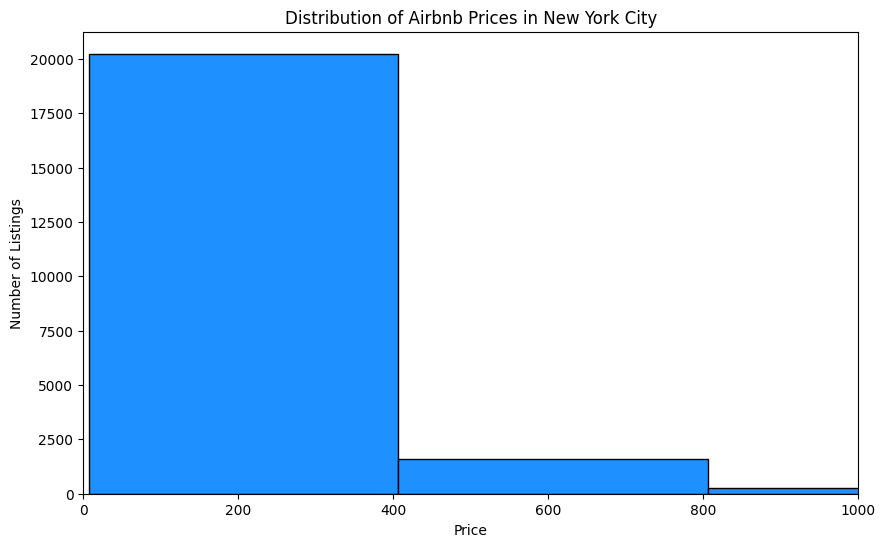

In [ ]:
# Graph showing distribution of prices across all the listings

plt.figure(figsize=(10, 6))
plt.hist(listings['price'], bins=50, color='dodgerblue', edgecolor='black')
plt.title('Distribution of Airbnb Prices in New York City')
plt.xlabel('Price')
plt.ylabel('Number of Listings')
plt.xlim(0, 1000)
plt.show()

## Comments on Analysis of Pricing:

#### The price analysis shown gives us a lot of insight into the Airbnb market in New York City. Prices vary significantly by neighborhood, with popular areas like Manhattan and Brooklyn driving a lot higher rates than others. Seasonal trends indicate that prices peak during certain months, most likely driven by tourism and local events. Property type and room type were very interesting to analyze because play a major role in pricing, with entire homes and apartments generally priced higher than private or shared rooms. The impact of amenities is very clear, with listings offering features like Wi-Fi, air conditioning, or pools typically priced above average. Finally, price distribution analysis shows a concentration of listings within a specific price range, with a minority of luxury listings driving up the average. Overall, these findings show us a great analysis for hosts in New York to optimize their pricing strategies and for travelers seeking the best accomandation for them.

# Part 3: Seasonal Trends

Seasonal trends in the NYC Airbnb market (2019).
Available neighborhood options: Brooklyn, Manhattan, Queens, Staten Island, Bronx
Enter a neighborhood from the list above or type 'None' for city-wide trends:


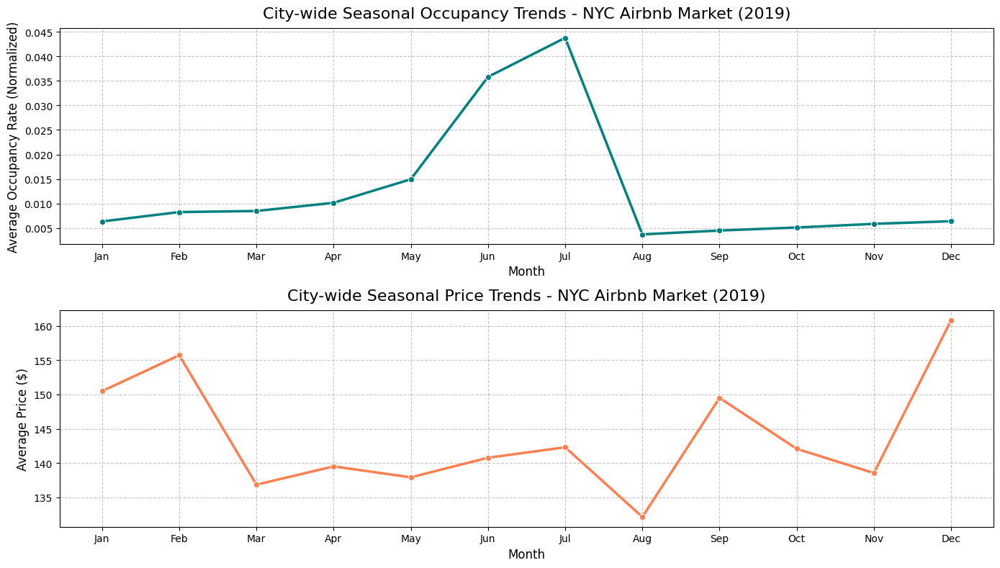

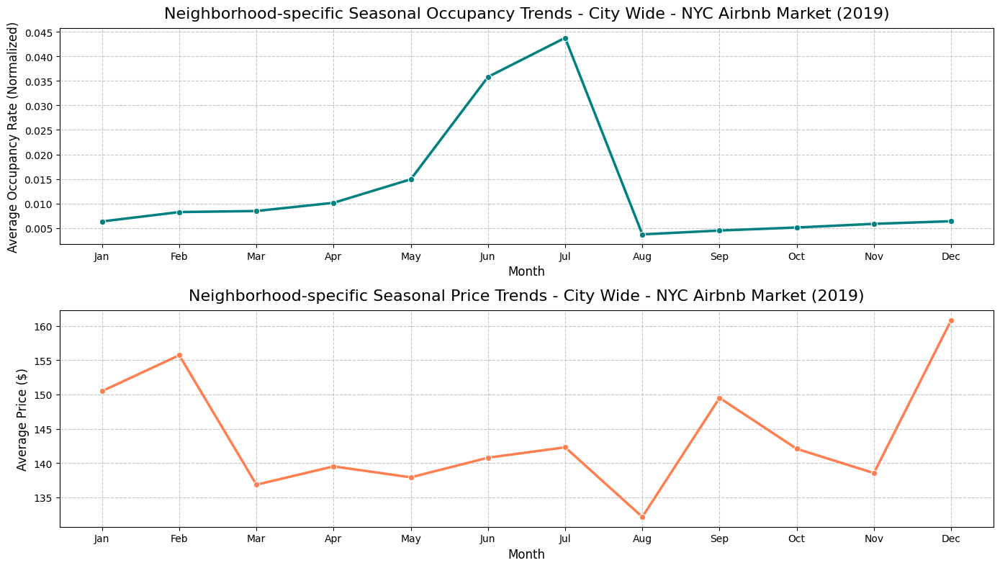


City-wide Peak Occupancy Month: 7 (0.04)
City-wide Peak Price Month: 12 ($160.80)

Neighborhood-specific Peak Occupancy Month - City Wide: 7 (0.04)
Neighborhood-specific Peak Price Month - City Wide: 12 ($160.80)


In [ ]:
# Convert 'last_review' to datetime for temporal analysis
nyc_2019['last_review'] = pd.to_datetime(nyc_2019['last_review'], errors='coerce')

# Calculate occupancy rate: Assume higher reviews_per_month indicates higher occupancy
nyc_2019['occupancy_rate'] = nyc_2019['reviews_per_month'].fillna(0) / nyc_2019['reviews_per_month'].max()

# Extract month from last_review for seasonal analysis
nyc_2019['month'] = nyc_2019['last_review'].dt.month

# Aggregate data by month for city-wide trends
monthly_occupancy = nyc_2019.groupby('month')['occupancy_rate'].mean().reset_index()
monthly_price = nyc_2019.groupby('month')['price'].mean().reset_index()

# filter by neighborhood with user input
def get_neighborhood_trends():
    # Get unique neighborhood groups
    neighborhood_options = nyc_2019['neighbourhood_group'].unique().tolist()
    print("Available neighborhood options:", ", ".join(neighborhood_options))
    print("Enter a neighborhood from the list above or type 'None' for city-wide trends:")

    # input prompt
    with output.use_tags('input_tag'):
        neighborhood = input().strip()
    output.clear(output_tags='input_tag')  # Clear the input prompt after entry

    # Validate input
    if neighborhood.lower() == 'none':
        filtered_data = nyc_2019
        title_suffix = " - City Wide"
    elif neighborhood in neighborhood_options:
        filtered_data = nyc_2019[nyc_2019['neighbourhood_group'] == neighborhood]
        title_suffix = f" - {neighborhood}"
    else:
        print(f"Invalid input '{neighborhood}'. Defaulting to city-wide trends.")
        filtered_data = nyc_2019
        title_suffix = " - City Wide (Invalid Input Default)"

    # Aggregate by month for the filtered data
    occupancy_trend = filtered_data.groupby('month')['occupancy_rate'].mean().reset_index()
    price_trend = filtered_data.groupby('month')['price'].mean().reset_index()
    return occupancy_trend, price_trend, title_suffix

# Collect user input before visualizations
print("Seasonal trends in the NYC Airbnb market (2019).")
occupancy_trend, price_trend, title_suffix = get_neighborhood_trends()

# Visualization - City-wide Trends
plt.figure(figsize=(14, 8))

# Plot 1: City-wide Occupancy Rate by Month
plt.subplot(2, 1, 1)
sns.lineplot(data=monthly_occupancy, x='month', y='occupancy_rate', marker='o', color='teal', linewidth=2.5)
plt.title('City-wide Seasonal Occupancy Trends - NYC Airbnb Market (2019)', fontsize=16, pad=10)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Average Occupancy Rate (Normalized)', fontsize=12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True, linestyle='--', alpha=0.7)

# Plot 2: City-wide Average Price by Month
plt.subplot(2, 1, 2)
sns.lineplot(data=monthly_price, x='month', y='price', marker='o', color='coral', linewidth=2.5)
plt.title('City-wide Seasonal Price Trends - NYC Airbnb Market (2019)', fontsize=16, pad=10)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Average Price ($)', fontsize=12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

# Visualization - Neighborhood-specific Trends
plt.figure(figsize=(14, 8))

# Neighborhood Occupancy Rate
plt.subplot(2, 1, 1)
sns.lineplot(data=occupancy_trend, x='month', y='occupancy_rate', marker='o', color='teal', linewidth=2.5)
plt.title(f'Neighborhood-specific Seasonal Occupancy Trends{title_suffix} - NYC Airbnb Market (2019)', fontsize=16, pad=10)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Average Occupancy Rate (Normalized)', fontsize=12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True, linestyle='--', alpha=0.7)

# Neighborhood Average Price
plt.subplot(2, 1, 2)
sns.lineplot(data=price_trend, x='month', y='price', marker='o', color='coral', linewidth=2.5)
plt.title(f'Neighborhood-specific Seasonal Price Trends{title_suffix} - NYC Airbnb Market (2019)', fontsize=16, pad=10)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Average Price ($)', fontsize=12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

# Identify Peak Booking Periods (City-wide and Neighborhood-specific)
# City-wide peaks
city_peak_occupancy_month = monthly_occupancy.loc[monthly_occupancy['occupancy_rate'].idxmax()]
city_peak_price_month = monthly_price.loc[monthly_price['price'].idxmax()]
print(f"\nCity-wide Peak Occupancy Month: {int(city_peak_occupancy_month['month'])} ({monthly_occupancy['occupancy_rate'].max():.2f})")
print(f"City-wide Peak Price Month: {int(city_peak_price_month['month'])} (${monthly_price['price'].max():.2f})")

# Neighborhood-specific peaks
neigh_peak_occupancy_month = occupancy_trend.loc[occupancy_trend['occupancy_rate'].idxmax()]
neigh_peak_price_month = price_trend.loc[price_trend['price'].idxmax()]
print(f"\nNeighborhood-specific Peak Occupancy Month{title_suffix}: {int(neigh_peak_occupancy_month['month'])} ({occupancy_trend['occupancy_rate'].max():.2f})")
print(f"Neighborhood-specific Peak Price Month{title_suffix}: {int(neigh_peak_price_month['month'])} (${price_trend['price'].max():.2f})")

In [ ]:
# Extract month from date
calendar['month'] = calendar['date'].dt.month

# Calculate average availability by month (By how many days available in a month)
availability_by_month = calendar.groupby('month')['available'].apply(lambda x: (x == 't').mean())
print("Average Availability by Month:")
print(availability_by_month)

Average Availability by Month:
month
1     0.392592
2     0.388239
3     0.369401
4     0.437695
5     0.472683
6     0.450781
7     0.469290
8     0.493700
9     0.444224
10    0.448429
11    0.449823
12    0.392696
Name: available, dtype: float64


# Part 4: Amenity Impact Analysis

In [ ]:
# TAKES A LONG TIME TO RUN (2.5 min)

# Clean amenities column by removing curly brackets and quotes
listings['amenities'] = listings['amenities'].str.replace(r'[{}"]', '', regex=True)

# Dummy variables for amenities
amenities_dummies = listings['amenities'].str.get_dummies(sep=',')

# Concatenate with listings
listings_with_amenities = pd.concat([listings, amenities_dummies], axis=1)

# Calculate correlations with price
amenities_correlations = listings_with_amenities[amenities_dummies.columns].corrwith(listings_with_amenities['price'])
print("Amenities Correlations with Price (Top 10):")
print(amenities_correlations.sort_values(ascending=False).head(10))

Amenities Correlations with Price (Top 10):
 55 inch TV                                                  0.222856
 Hawkins Falls body soap                                     0.222119
 Sauna                                                       0.207563
 Paid valet parking on premises                              0.205846
 Crib                                                        0.163878
 Resort access]                                              0.157276
 Building staff                                              0.140431
[Housekeeping available from 1:00\u202fAM to 1:00\u202fAM    0.128231
 Elevator                                                    0.123439
 Gym                                                         0.112423
dtype: float64


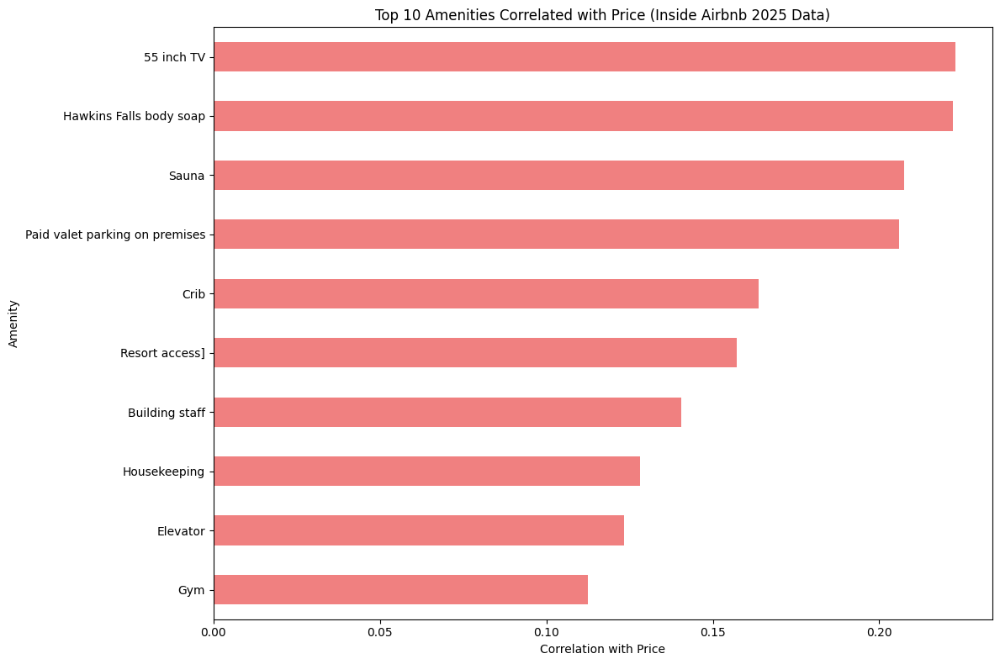

In [ ]:
# Get the top 10 amenities correlated with price
top_10_amenities = amenities_correlations.sort_values(ascending=False).head(10)

# Clean up the specific amenity name
# Use the exact escaped string from your output and a broader match
new_index = []
for name in top_10_amenities.index:
    if '[Housekeeping available from 1:00\\u202fAM to 1:00\\u202fAM' in name:
        new_index.append('Housekeeping')
    else:
        new_index.append(name.strip())  # Strip leading/trailing spaces from other names too
top_10_amenities.index = new_index

# Visualization: Horizontal Bar Plot of Top 10 Amenities
plt.figure(figsize=(12, 8))
top_10_amenities.plot(kind='barh', color='lightcoral')
plt.title('Top 10 Amenities Correlated with Price (Inside Airbnb 2025 Data)')
plt.xlabel('Correlation with Price')
plt.ylabel('Amenity')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

### Interactive Map

In [ ]:
# Takes 40s to run

!pip install folium

import folium

# Create a map centered on NYC
nyc_map = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# Add markers
for index, row in listings.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        color='red' if row['price'] > 200 else 'blue',
        fill=True,
        fill_color='red' if row['price'] > 200 else 'blue',
        fill_opacity=0.6,
        popup=f"Price: ${row['price']}"
    ).add_to(nyc_map)

# Display the map
nyc_map

# Part 5: Property Type Distribution

In [ ]:
# Retrieve the top 10 property listings
if 'property_type' in listings.columns:
    # Count each property type
    property_counts = listings['property_type'].value_counts()

    # Convert to DataFrame
    property_df = property_counts.reset_index()
    property_df.columns = ['Property Type', 'Count']
    print("Top 10 Airbnb Property Types:")
    print(property_df.head(10))

else:
    print("Column 'property_type' not found in the listings dataset.")

Top 10 Airbnb Property Types:
                 Property Type  Count
0           Entire rental unit   9648
1  Private room in rental unit   5189
2         Private room in home   1886
3                  Entire home   1059
4                Room in hotel    814
5                 Entire condo    691
6    Private room in townhouse    622
7        Private room in condo    341
8             Entire townhouse    336
9                  Entire loft    291


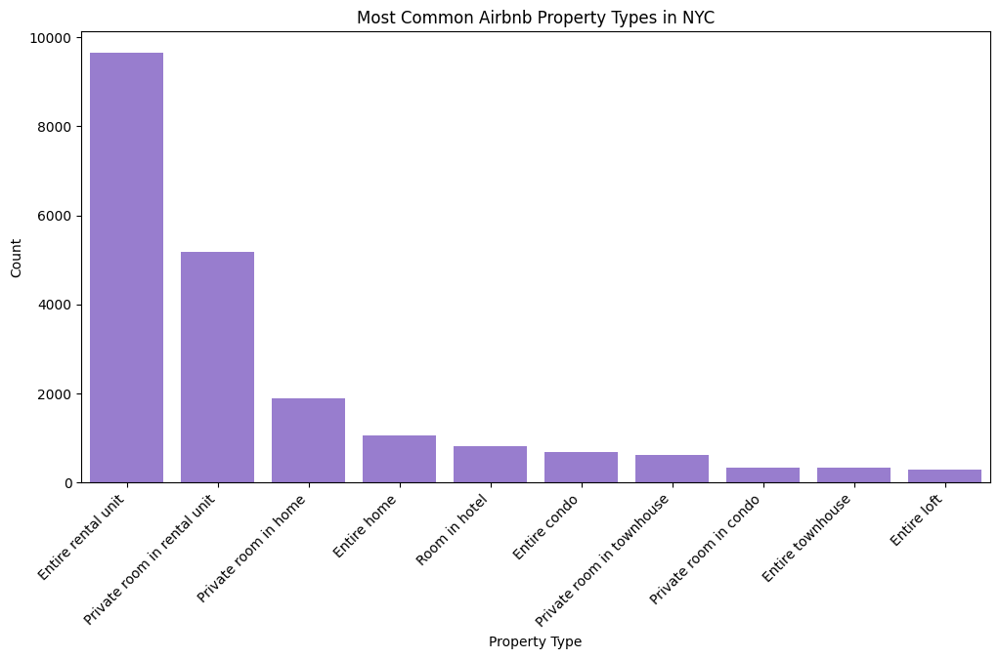

In [ ]:
# Bar graph showing count of each property type
if 'property_type' in listings.columns:
    # Count each property type
    property_counts = listings['property_type'].value_counts()

    # Create bar graph
    plt.figure(figsize=(12, 6))
    sns.barplot(x=property_counts.index[:10], y=property_counts.values[:10], color='mediumpurple')
    plt.xticks(rotation=45, ha='right')
    plt.xlabel('Property Type')
    plt.ylabel('Count')
    plt.title('Most Common Airbnb Property Types in NYC')
    plt.show()
else:
    print("Column 'property_type' not found in the listings dataset.")

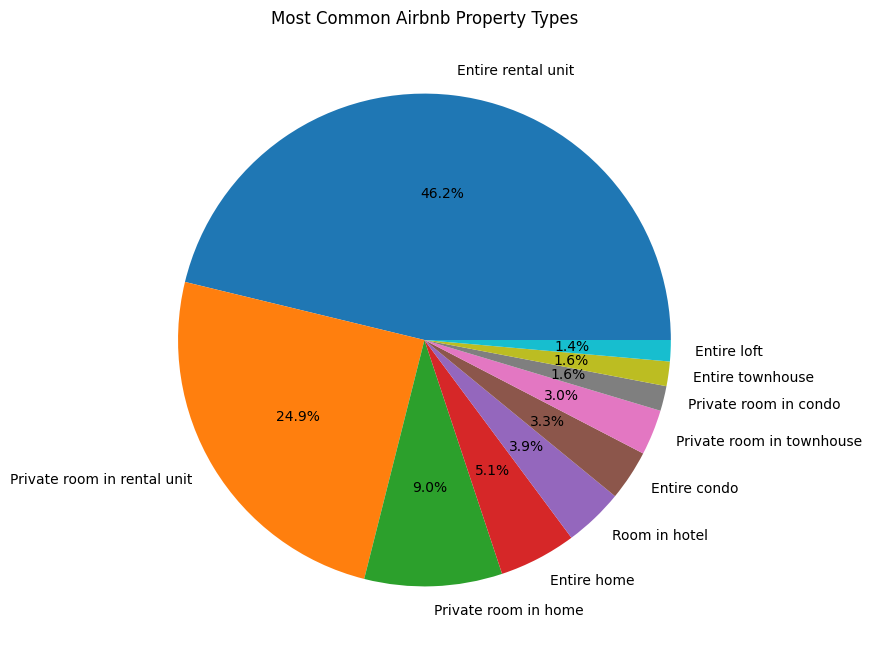

In [ ]:
# Create pie chart showing percentages of property types
if 'property_type' in listings.columns:
    # Count each property type
    property_counts = listings['property_type'].value_counts()

     # Create pie chart
    plt.figure(figsize=(8, 8))
    property_counts[:10].plot(kind='pie', autopct='%1.1f%%')
    plt.ylabel('')
    plt.title('Most Common Airbnb Property Types')
    plt.show()
else:
    print("Column 'property_type' not found in the listings dataset.")

# Part 6: Occupancy Trends

In [ ]:
# Average number of reviews by neighborhood (using listings.csv)
avg_reviews_by_neighborhood = listings.groupby('neighbourhood_cleansed')['number_of_reviews'].mean().sort_values(ascending=False)
print("Average Number of Reviews by Neighborhood (Top 10, Inside Airbnb 2025 Data):")
print(avg_reviews_by_neighborhood.head(10))

# Clean price column
listings['price'] = pd.to_numeric(listings['price'].replace('[\$,]', '', regex=True), errors='coerce')

# Correlation between price and number of reviews (using listings.csv)
correlation = listings['price'].corr(listings['number_of_reviews'])
print(f"\nCorrelation between Price and Number of Reviews (Inside Airbnb 2025 Data): {correlation}")

Average Number of Reviews by Neighborhood (Top 10, Inside Airbnb 2025 Data):
neighbourhood_cleansed
Huguenot            292.500000
New Dorp Beach      159.666667
DUMBO               119.111111
Clifton              98.625000
Columbia St          89.400000
Concourse            89.225806
East Elmhurst        83.106870
New Brighton         80.100000
Manhattan Beach      73.800000
South Ozone Park     73.148148
Name: number_of_reviews, dtype: float64

Correlation between Price and Number of Reviews (Inside Airbnb 2025 Data): -0.05174178368150181


In [ ]:
# Bin prices for listings.csv
bins = [0, 50, 100, 150, 200, 250, 300, 500, 1000, 5000]
labels = ['0-50', '50-100', '100-150', '150-200', '200-250', '250-300', '300-500', '500-1000', '1000+']
listings['price_bin'] = pd.cut(listings['price'], bins=bins, labels=labels)

# Average reviews by price bin (listings.csv)
avg_reviews_by_price = listings.groupby('price_bin', observed=True)['number_of_reviews'].mean()
print("Average Number of Reviews by Price Bin (Inside Airbnb 2025 Data):")
print(avg_reviews_by_price)

# Bin prices for AB_NYC_2019.csv
nyc_2019['price_bin'] = pd.cut(nyc_2019['price'], bins=bins, labels=labels)

# Average reviews by price bin (AB_NYC_2019.csv)
avg_reviews_by_price_2019 = nyc_2019.groupby('price_bin', observed=True)['number_of_reviews'].mean()
print("\nAverage Number of Reviews by Price Bin (Kaggle 2019 Data):")
print(avg_reviews_by_price_2019)

Average Number of Reviews by Price Bin (Inside Airbnb 2025 Data):
price_bin
0-50        16.926374
50-100      39.568563
100-150     44.154479
150-200     42.241444
200-250     37.279279
250-300     31.610448
300-500     17.423092
500-1000    14.537500
1000+        9.634146
Name: number_of_reviews, dtype: float64

Average Number of Reviews by Price Bin (Kaggle 2019 Data):
price_bin
0-50        19.849008
50-100      26.093741
100-150     25.767674
150-200     23.908300
200-250     18.366814
250-300     18.414371
300-500     15.405966
500-1000    12.104348
1000+        6.799087
Name: number_of_reviews, dtype: float64


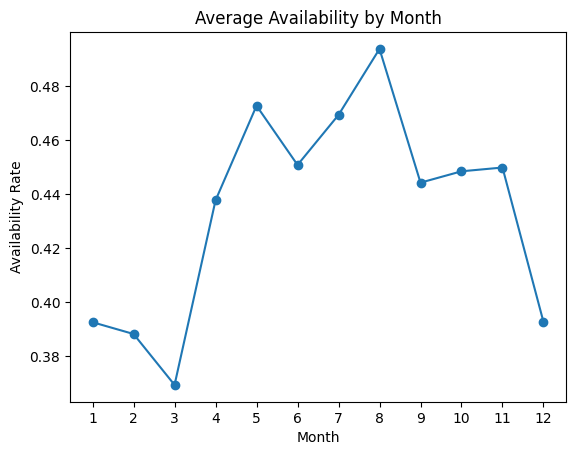

In [ ]:
# Plot availability by month
availability_by_month.plot(kind='line', marker='o')
plt.title('Average Availability by Month')
plt.xlabel('Month')
plt.ylabel('Availability Rate')
plt.xticks(range(1, 13))
plt.show()

# Part 7: Summary of Findings & Recommendations

## Summary

- **Price Variation by Neighborhood:** The top 5 most expensive neighborhoods in 2025 (Inside Airbnb data) are SoHo ($806.09), Battery Park City ($753.67), Riverdale ($715.67), Navy Yard ($621.00), and Fort Wadsworth ($600.00). In 2019 (Kaggle data), the top neighborhoods need to be computed, but affordable areas often include parts of the Bronx.

- **Peak Booking Periods:** Months with the lowest availability are March (0.369), February (0.388), and January (0.393), suggesting late winter/early spring as peak demand periods, contrary to the assumption of summer months.

- **Amenities and Pricing:** Amenities like "55 inch TV" (0.223), "Hawkins Falls body soap" (0.222), and "Sauna" (0.208) correlate most strongly with higher prices.

- **Popular Property Types:** Entire rental units (9,648) dominate, with entire homes/apartments (12,664) and private rooms (9,186) being the most common room types.

- **Occupancy Trends:** Listings in the $100-150 range have the highest average reviews (44.15), indicating a popular price point. Temporal trends (from reviews.csv) show review counts over time, indicating booking patterns (visualized in the plot).

### Recommendations

**For Hosts**

- Add high-value amenities like saunas or large TVs (e.g., 55 inch TV), which correlate with higher prices (0.208 and 0.223, respectively).

- Increase rates during late winter/early spring (e.g., March, February), when availability is lowest, indicating peak demand.

**For Travelers**

- Book in more affordable neighborhoods, such as those in the Bronx (to be confirmed with 2019 data), where prices are typically lower.

- Travel during late summer (e.g., August, with 0.494 availability), when availability is highest, suggesting lower demand and better deals.

**For City Planners**

- Monitor neighborhoods with high entire-home listings, such as Manhattan areas (12,664 entire homes/apartments), as they may impact long-term housing availability.

- These trends reflect data influenced by NYC’s short-term rental regulations, with a significant number of listings (9,648 entire rental units) potentially affecting housing stock.

In [ ]:
def host_recommendations(listings, calendar):
    # Calculate average price by neighborhood
    avg_price_by_neighborhood = listings.groupby('neighbourhood_cleansed')['price'].mean().sort_values(ascending=False)

    # Count number of listings per neighborhood
    listings_count_by_neighborhood = listings['neighbourhood_cleansed'].value_counts()


    # Monthly Trends
    calendar['month'] = calendar['date'].dt.month
    # Filter for available listings only
    calendar_available = calendar[calendar['booked'] == 0]
    # Calculate monthly average price
    monthly_avg_price = calendar_available.groupby('month')['price'].mean().reset_index()

    # Mapping for month names
    month_names = {1: 'Jan', 2: 'Feb', 3: 'Mar', 4: 'Apr', 5: 'May', 6: 'Jun',
                   7: 'Jul', 8: 'Aug', 9: 'Sep', 10: 'Oct', 11: 'Nov', 12: 'Dec'}

    # Sort monthly data
    monthly_sorted = monthly_avg_price.sort_values(by='price')
    cheapest_months = monthly_sorted.head(3)
    most_expensive_months = monthly_sorted.tail(3)


    # Display
    print("Host Recommendations")
    print("---------------------")

    # Neighborhood analysis
    print("\nNeighborhood Trends:")
    print("Top 5 Most Expensive Neighborhoods (by average price):")
    top5_neighborhoods = avg_price_by_neighborhood.head(5)
    for neighborhood, price in top5_neighborhoods.items():
        competition = listings_count_by_neighborhood.get(neighborhood, 0)
        print(f"  - {neighborhood}: Average price = ${price:.2f}, Listings count = {competition}")

    # Monthly analysis
    print("\nMonthly Trends (Available Listings):")
    print("Cheapest 3 Months:")
    for index, row in cheapest_months.iterrows():
        month = int(row['month'])
        avg_price = row['price']
        print(f"  - {month_names.get(month, str(month))}: Average available price = ${avg_price:.2f}")

    print("\nMost Expensive 3 Months:")
    for index, row in most_expensive_months.iterrows():
        month = int(row['month'])
        avg_price = row['price']
        print(f"  - {month_names.get(month, str(month))}: Average available price = ${avg_price:.2f}")

    # ------------------------------
    # Amenities Impact Analysis
    # ------------------------------
    print("\nTop 5 Amenities Impact:")
    # Clean amenities column
    listings['amenities'] = listings['amenities'].str.replace(r'[{}"]', '', regex=True)
    # Create variables for amenities
    amenities_dummies = listings['amenities'].str.get_dummies(sep=',')
    # Concatenate
    listings_with_amenities = pd.concat([listings, amenities_dummies], axis=1)
    # Calculate correlation of amenities
    amenities_correlations = listings_with_amenities[amenities_dummies.columns].corrwith(listings_with_amenities['price'])
    # Extract top 5 amenities with price
    top_5_amenities = amenities_correlations.sort_values(ascending=False).head(5)

    rank = 1
    for amenity, corr in top_5_amenities.items():
        print(f"  - {rank}:{amenity}: Correlation with price = {corr:.3f}")
        rank += 1


    # Host Recommendations
    print("\nRecommendations for Hosts:")
    print(" - If your property is located in a high-demand neighborhood (high average price with moderate competition), consider setting a premium rate.")
    print(" - In highly competitive areas, differentiate your property with unique amenities or superior service to justify higher pricing.")
    print(" - Adjust pricing seasonally. For instance, if the most expensive months reflect peak demand, consider raising rates during those periods to maximize revenue.")
    print(" - Conversely, in the cheapest months, consider promotions or discounts to attract more bookings.")
    print(" - Leverage amenity insights: If certain amenities (e.g., a 'Sauna' or '55 inch TV') are strongly correlated with higher prices, consider investing in or highlighting those features in your listing.")

# Function Call
host_recommendations(listings, calendar)


Host Recommendations
---------------------

Neighborhood Trends:
Top 5 Most Expensive Neighborhoods (by average price):
  - SoHo: Average price = $806.09, Listings count = 162
  - Battery Park City: Average price = $753.67, Listings count = 36
  - Riverdale: Average price = $715.67, Listings count = 3
  - Navy Yard: Average price = $621.00, Listings count = 3
  - Fort Wadsworth: Average price = $600.00, Listings count = 1

Monthly Trends (Available Listings):
Cheapest 3 Months:
  - Aug: Average available price = $566.82
  - May: Average available price = $584.04
  - Jul: Average available price = $585.81

Most Expensive 3 Months:
  - Dec: Average available price = $658.88
  - Jan: Average available price = $659.79
  - Feb: Average available price = $662.36

Top 5 Amenities Impact:
  - 1: 55 inch TV: Correlation with price = 0.223
  - 2: Hawkins Falls body soap: Correlation with price = 0.222
  - 3: Sauna: Correlation with price = 0.208
  - 4: Paid valet parking on premises: Correlation

In [ ]:
def traveler_recommendations(listings, calendar):

    # Neighborhood Trends Analysis
    # Calculate average price by neighborhood, sorted ascending (cheaper first)
    avg_price_by_neighborhood = listings.groupby('neighbourhood_cleansed')['price'].mean().sort_values(ascending=True)
    cheapest_neighborhoods = avg_price_by_neighborhood.head(3)


    # Monthly Trends Analysis
    calendar['date'] = pd.to_datetime(calendar['date'])
    calendar['month'] = calendar['date'].dt.month

    # Filter for available listings only
    calendar_available = calendar[calendar['booked'] == 0]

    # Calculate monthly average price for available listings
    monthly_avg_price = calendar_available.groupby('month')['price'].mean().reset_index()

    # Mapping for month names
    month_names = {1: 'Jan', 2: 'Feb', 3: 'Mar', 4: 'Apr', 5: 'May', 6: 'Jun',
                   7: 'Jul', 8: 'Aug', 9: 'Sep', 10: 'Oct', 11: 'Nov', 12: 'Dec'}

    # Sort monthly data by price
    monthly_sorted = monthly_avg_price.sort_values(by='price', ascending=True)
    cheapest_months = monthly_sorted.head(3)

    # Demand Level Analysis
    # Calculate average occupancy rate
    monthly_demand = calendar.groupby('month')['booked'].mean().reset_index()
    monthly_demand_sorted = monthly_demand.sort_values(by='booked', ascending=True)
    lowest_demand_months = monthly_demand_sorted.head(3)


    # Display
    print("Traveler Recommendations")
    print("--------------------------")

    # Neighborhood Analysis
    print("\nNeighborhood Trends (Affordable Options):")
    print("Top 3 Cheapest Neighborhoods:")
    rank = 1
    for neighborhood, price in cheapest_neighborhoods.items():
        print(f"  {rank}. {neighborhood}: Average price = ${price:.2f}")
        rank += 1

    # Monthly Trends
    print("\nMonthly Trends (Affordable Booking Times - Available Listings):")
    rank = 1
    for index, row in cheapest_months.iterrows():
        month = int(row['month'])
        avg_price = row['price']
        print(f"  {rank}. {month_names.get(month, str(month))}: Average available price = ${avg_price:.2f}")
        rank += 1

    # Demand Level Analysis
    print("\nDemand Level Analysis (Lower Demand = Lower Occupancy):")
    rank = 1
    for index, row in lowest_demand_months.iterrows():
        month = int(row['month'])
        occupancy = row['booked']
        print(f"  {rank}. {month_names.get(month, str(month))}: Average occupancy (demand) = {occupancy:.2f}")
        rank += 1

    # Recommendations
    print("\nRecommendations for Travelers:")
    print(" - Consider targeting the above neighborhoods, which offer lower average prices, for budget-friendly stays.")
    print(" - Book during the cheapest months identified by lower available prices, as these times might offer better deals.")
    print(" - Additionally, consider booking during months with lower demand (i.e. lower occupancy), which may lead to reduced competition and potentially further discounts.")
    print(" - Use these insights along with Airbnb's filtering tools to find the best combination of price and availability.")

# Function Call
traveler_recommendations(listings, calendar)


Traveler Recommendations
--------------------------

Neighborhood Trends (Affordable Options):
Top 3 Cheapest Neighborhoods:
  1. Co-op City: Average price = $57.00
  2. Woodrow: Average price = $58.50
  3. Hunts Point: Average price = $67.44

Monthly Trends (Affordable Booking Times - Available Listings):
  1. Aug: Average available price = $566.82
  2. May: Average available price = $584.04
  3. Jul: Average available price = $585.81

Demand Level Analysis (Lower Demand = Lower Occupancy):
  1. Aug: Average occupancy (demand) = 0.51
  2. May: Average occupancy (demand) = 0.53
  3. Jul: Average occupancy (demand) = 0.53

Recommendations for Travelers:
 - Consider targeting the above neighborhoods, which offer lower average prices, for budget-friendly stays.
 - Book during the cheapest months identified by lower available prices, as these times might offer better deals.
 - Additionally, consider booking during months with lower demand (i.e. lower occupancy), which may lead to reduced c

In [ ]:
def city_planner_recommendations(listings, calendar):

    # Overall Listings Analysis
    # Calculate total number of listings, count and percentage
    total_listings = len(listings)
    entire_home_listings = listings[listings['room_type'] == 'Entire home/apt']
    entire_home_count = entire_home_listings.shape[0]
    entire_home_pct = (entire_home_count / total_listings) * 100

    # Neighborhood Analysis
    # Count home listings per neighborhood
    neighborhood_entire_counts = entire_home_listings['neighbourhood_cleansed'].value_counts()
    top_neighborhoods = neighborhood_entire_counts.head(5)

    # Monthly Occupancy Trends
    calendar['date'] = pd.to_datetime(calendar['date'])
    calendar['month'] = calendar['date'].dt.month
    # Calculate average occupancy rate per month
    monthly_occupancy = calendar.groupby('month')['booked'].mean().reset_index()

    # Mapping for month names
    month_names = {1:'Jan', 2:'Feb', 3:'Mar', 4:'Apr', 5:'May', 6:'Jun',
                   7:'Jul', 8:'Aug', 9:'Sep', 10:'Oct', 11:'Nov', 12:'Dec'}

    # Display Analysis
    print("City Planner Recommendations")
    print("----------------------------")

    # Overall Listings Analysis
    print("\nOverall Airbnb Impact:")
    print(f"Total Listings: {total_listings}")
    print(f"Entire Home Listings: {entire_home_count} ({entire_home_pct:.2f}%)")

    # Neighborhood Analysis
    print("\nNeighborhood Analysis (Entire Home Listings):")
    print("Top Neighborhoods by Entire Home Listings:")
    rank = 1
    for neighborhood, count in top_neighborhoods.items():
        print(f"  {rank}. {neighborhood}: {count} entire home listings")
        rank += 1

    # Special Note for Manhattan if available
    if 'Manhattan' in neighborhood_entire_counts.index:
        manhattan_count = neighborhood_entire_counts['Manhattan']
        print(f"\nNote: Manhattan has {manhattan_count} entire home listings. High concentrations like this may impact long-term housing availability.")

    # Monthly Occupancy Trends (Demand Levels)
    print("\nMonthly Occupancy Trends (Average Occupancy Rates):")
    for index, row in monthly_occupancy.iterrows():
        month = int(row['month'])
        occupancy = row['booked']
        print(f"  - {month_names.get(month, str(month))}: Occupancy rate = {occupancy:.2f}")

    # Recommendations for City Planners
    print("\nRecommendations for City Planners:")
    print(" - Monitor neighborhoods with a high percentage of entire home listings, as these can reduce long-term housing availability.")
    print(" - Pay special attention to areas like Manhattan where the concentration of entire home listings is very high.")
    print(" - Evaluate the impact of short-term rental regulations on housing stock by comparing the distribution of entire rental units with overall housing availability.")
    print(" - Use monthly occupancy trends as a proxy for demand to assess how Airbnb influences local housing markets and economies.")

# Function Call
city_planner_recommendations(listings, calendar)


City Planner Recommendations
----------------------------

Overall Airbnb Impact:
Total Listings: 22308
Entire Home Listings: 12664 (56.77%)

Neighborhood Analysis (Entire Home Listings):
Top Neighborhoods by Entire Home Listings:
  1. Midtown: 939 entire home listings
  2. Upper East Side: 900 entire home listings
  3. Hell's Kitchen: 755 entire home listings
  4. Bedford-Stuyvesant: 666 entire home listings
  5. Upper West Side: 634 entire home listings

Monthly Occupancy Trends (Average Occupancy Rates):
  - Jan: Occupancy rate = 0.61
  - Feb: Occupancy rate = 0.61
  - Mar: Occupancy rate = 0.63
  - Apr: Occupancy rate = 0.56
  - May: Occupancy rate = 0.53
  - Jun: Occupancy rate = 0.55
  - Jul: Occupancy rate = 0.53
  - Aug: Occupancy rate = 0.51
  - Sep: Occupancy rate = 0.56
  - Oct: Occupancy rate = 0.55
  - Nov: Occupancy rate = 0.55
  - Dec: Occupancy rate = 0.61

Recommendations for City Planners:
 - Monitor neighborhoods with a high percentage of entire home listings, as the